In [3]:
import requests
import pandas as pd
import json
import time
import gzip

file_path = '../data/reviews.clean.json.gz'

def read_reviews(file_path):
    with gzip.open(file_path) as file:
        for line_number, line in enumerate(file, start=0):
            # review = json.loads(eval(line))
            review = eval(line)
            yield review

# Đặt địa chỉ URL của API local
local_api_url = 'http://127.0.0.1:5000/api/ie212_o11_group7/endpoint'

x = 0
# Lặp qua từng dòng của DataFrame và gửi request POST mỗi 5 giây
for review in read_reviews(file_path):     
    try:      
        # Convert the review to a JSON string
        review['last_update_time'] = time.time()
        message_value = json.dumps(review)
        
        # Gửi request POST đến API local với dữ liệu JSON
        response = requests.post(local_api_url, json=message_value)
        
        # Kiểm tra kết quả của request
        if response.status_code == 200:
            x += 1
            print(f"Gửi dữ liệu {x} đã được đẩy lên thành công.")
        else:
            print("Đã có lỗi xảy ra:", response.status_code, response.text)

        # Đợi 5 giây trước khi gửi dòng tiếp theo
        time.sleep(1)
    except Exception as e:
            print(f"An error occurred: {e}")

FileNotFoundError: [Errno 2] No such file or directory: '../data/reviews.clean.json.gz'

In [ ]:
import requests
import pandas as pd
import json
import time
import gzip


# Đặt địa chỉ URL của API local
local_api_url = 'http://127.0.0.1:5000/api/ie212_o11_group7/endpoint'
# local_api_url = 'http://127.0.0.1:5000/api/ie212_o11_group7/pos_neg_endpoint'

# Load the data into a DataFrame (you may need to adjust this based on your data structure)
df = pd.read_csv('df_ca.csv')

x = 0
# Lặp qua từng dòng của DataFrame và gửi request POST mỗi 5 giây
for index, row in df.iterrows():  
    try:
        # Convert the row to a dictionary
        review = row.to_dict()

        # Add a timestamp to the review
        review['last_update_time'] = time.time()
        
        # Convert the review to a JSON string
        message_value = json.dumps(review)
        
        # Gửi request POST đến API local với dữ liệu JSON
        response = requests.post(local_api_url, json=message_value)
        
        # Kiểm tra kết quả của request
        if response.status_code == 200:
            x += 1
            print(f"Gửi dữ liệu {x} đã được đẩy lên thành công.")
        else:
            print("Đã có lỗi xảy ra:", response.status_code, response.text)

        # Đợi 5 giây trước khi gửi dòng tiếp theo
        time.sleep(5)
    
    except Exception as e:
        print(f"An error occurred: {e}")


Gửi dữ liệu 1 đã được đẩy lên thành công.
Gửi dữ liệu 2 đã được đẩy lên thành công.
Gửi dữ liệu 3 đã được đẩy lên thành công.
Gửi dữ liệu 4 đã được đẩy lên thành công.
Gửi dữ liệu 5 đã được đẩy lên thành công.
Gửi dữ liệu 6 đã được đẩy lên thành công.
Gửi dữ liệu 7 đã được đẩy lên thành công.
Gửi dữ liệu 8 đã được đẩy lên thành công.
Gửi dữ liệu 9 đã được đẩy lên thành công.
Gửi dữ liệu 10 đã được đẩy lên thành công.
Gửi dữ liệu 11 đã được đẩy lên thành công.
Gửi dữ liệu 12 đã được đẩy lên thành công.
Gửi dữ liệu 13 đã được đẩy lên thành công.
Gửi dữ liệu 14 đã được đẩy lên thành công.
Gửi dữ liệu 15 đã được đẩy lên thành công.
Gửi dữ liệu 16 đã được đẩy lên thành công.
Gửi dữ liệu 17 đã được đẩy lên thành công.
Gửi dữ liệu 18 đã được đẩy lên thành công.
Gửi dữ liệu 19 đã được đẩy lên thành công.
Gửi dữ liệu 20 đã được đẩy lên thành công.
Gửi dữ liệu 21 đã được đẩy lên thành công.
Gửi dữ liệu 22 đã được đẩy lên thành công.
Gửi dữ liệu 23 đã được đẩy lên thành công.
Gửi dữ liệu 24 đã đư

In [ ]:
def transform_row_to_json(row):
    transformed_data = {
        "rating": row.rating,
        "reviewerName": row.reviewerName,
        "reviewText": row.reviewText,
        "categories": json.loads(row.categories),
        "gPlusPlaceId": row.gPlusPlaceId,
        "unixReviewTime": row.unixReviewTime,
        "reviewTime": row.reviewTime,
        "gPlusUserId": row.gPlusUserId
    }
    return json.dumps(transformed_data)

In [ ]:
import pandas as pd

# Đường dẫn tuyệt đối của file CSV trên máy tính của bạn
csv_file_path = 'df_ca.csv'

# Đọc dữ liệu từ file CSV
df = pd.read_csv(csv_file_path)
data = pd.DataFrame(df)

# Creating DataFrame
reviews_temp_df = pd.DataFrame(data)

# Convert Unix timestamps to datetime objects
reviews_temp_df['review_date'] = pd.to_datetime(reviews_temp_df['unixReviewTime'], unit='s')

# Extract the year from the datetime objects and create a 'year' column
reviews_temp_df['year'] = reviews_temp_df['review_date'].dt.year
reviews_temp_df['month'] = reviews_temp_df['review_date'].dt.month

# Creating columns for each rating
for i in range(6):
    reviews_temp_df[f'{i}_star'] = reviews_temp_df['rating'] == i

# Creating columns for the total number of stars and reviews
reviews_temp_df['total_stars'] = reviews_temp_df.loc[:, '0_star':'5_star'].sum(axis=1)
reviews_temp_df['total_reviews'] = reviews_temp_df['reviewText'].notna().astype(int)

# Grouping by year and calculating the sum for each group
result_df = reviews_temp_df.groupby('year').agg({
    '0_star': 'sum',
    '1_star': 'sum',
    '2_star': 'sum',
    '3_star': 'sum',
    '4_star': 'sum',
    '5_star': 'sum',
    'total_stars': 'sum',
    'rating': 'mean',
    'total_reviews': 'sum'
}).reset_index()

# Renaming the 'avg_rating' column for clarity
result_df = result_df.rename(columns={'rating': 'avg_star'})

# Displaying the result
print(result_df)


    year  0_star  1_star  2_star  3_star  4_star  5_star  total_stars  \
0   1990       0       0       2       9     102      25          138   
1   2002       0       0       0       2       2       0            4   
2   2003       0       0       1       0       2       1            4   
3   2004       0       0       2      20      48      26           96   
4   2005       0       0       6      26      73      29          134   
5   2006       0       0       6      45     119      37          207   
6   2007       0       5      15      46     109      74          249   
7   2008       0      43      28      62     111     127          371   
8   2009       0      76      38      81     258     272          725   
9   2010       0     210     209     495    1156    1392         3462   
10  2011       0     708     529    1071    2641    3383         8332   
11  2012       0     581    1914    3076    6066    8864        20501   
12  2013       1    2019    3211    5196    9767   

In [ ]:
# Grouping by year and calculating the sum for each group
result_df = reviews_temp_df.agg({
    '0_star': 'sum',
    '1_star': 'sum',
    '2_star': 'sum',
    '3_star': 'sum',
    '4_star': 'sum',
    '5_star': 'sum',
    'total_stars': 'sum',
    'rating': 'mean',
    'total_reviews': 'sum'
}).reset_index()

print(result_df)

           index             0
0         0_star      1.000000
1         1_star   4846.000000
2         2_star   6459.000000
3         3_star  10876.000000
4         4_star  22098.000000
5         5_star  31974.000000
6    total_stars  76254.000000
7         rating      3.916568
8  total_reviews  76254.000000


In [ ]:
import plotly.express as px

# Filter data for years from 2010 onwards
df_temp = result_df
selected_rows = df_temp[df_temp['index'].str.endswith('_star')]
labels = selected_rows['index'].tolist()
sizes = selected_rows[0].tolist()
rating_mean = df[df['index'] == 'rating'][0].values[0]

# Đảo ngược thứ tự của labels và sizes
labels.reverse()
sizes.reverse()

# Colors
colors = ['#fff363', '#fde725', '#9fda3a', '#1fa187', '#004ebe', '#002f72']
colors.reverse()

# Tạo biểu đồ vòng khuyên
fig = px.pie(df_temp, values=sizes, names=labels, hole=0.4, title='Distribution of Ratings', color_discrete_sequence=colors,
             category_orders={'names': labels})  # Define the order of slices

fig.update_traces(textposition='inside', textfont_size=14)

# Thêm text annotation cho giá trị trung bình của "rating"
fig.add_annotation(
    text=f'{rating_mean:.2f} \u2605',
    x=0.5, y=0.5,  # Vị trí của text annotation trong biểu đồ
    showarrow=False,
    font=dict(size=24, color='#fbb040',)
)

# Hiển thị biểu đồ
fig.show()


In [ ]:
import pandas as pd

def extract_lat_long_from_gps(df, gps_column='gps'):
    # Function to extract latitude and longitude from a string
    def extract_lat_long(coord_str):
        try:
            coordinates = eval(coord_str)
            if len(coordinates) == 2:
                return pd.Series({'latitude': coordinates[0], 'longitude': coordinates[1]})
            else:
                raise ValueError("Invalid coordinate format")
        except (SyntaxError, ValueError):
            return pd.Series({'latitude': None, 'longitude': None})

    # Apply the extract_lat_long function to the specified column
    df[['latitude', 'longitude']] = df[gps_column].apply(extract_lat_long)

    return df

# Example usage:
# Assuming df is your DataFrame with a column named 'gps'
df = pd.read_csv(csv_file_path)
# df = pd.DataFrame({'gps': ["[40.179159, -122.236162]", "[37.774929, -122.419416]"]})

# Apply the function to extract latitude and longitude
df = extract_lat_long_from_gps(df)

# Display the DataFrame with new columns
print(df.columns)


Index(['Unnamed: 0', 'rating', 'reviewerName', 'reviewText', 'categories',
       'gPlusPlaceId', 'unixReviewTime', 'reviewTime', 'gPlusUserId', 'gps',
       'price', 'dtime', 'hour', 'minute', 'second', 'latitude', 'longitude'],
      dtype='object')


In [ ]:
import pandas as pd
from faker import Faker
import random

# Khởi tạo mô-đun Faker để tạo dữ liệu giả định
fake = Faker()

# Tạo DataFrame mẫu
data = {
    'reviewText': [fake.paragraph() for _ in range(100)],
    'rating': [random.randint(0, 5) for _ in range(100)],
}

df_sample = pd.DataFrame(data)

# In và hiển thị 5 dòng đầu tiên của DataFrame mẫu
print(df_sample.head())


                                          reviewText  rating
0  Walk go pick hot accept early. Enough trial be...       3
1  Little threat which know myself style feel. Ah...       1
2  Decade pretty draw idea shake news. Result los...       4
3  Care buy reduce central policy senior. Do hair...       4
4  Billion event continue which away happy televi...       3


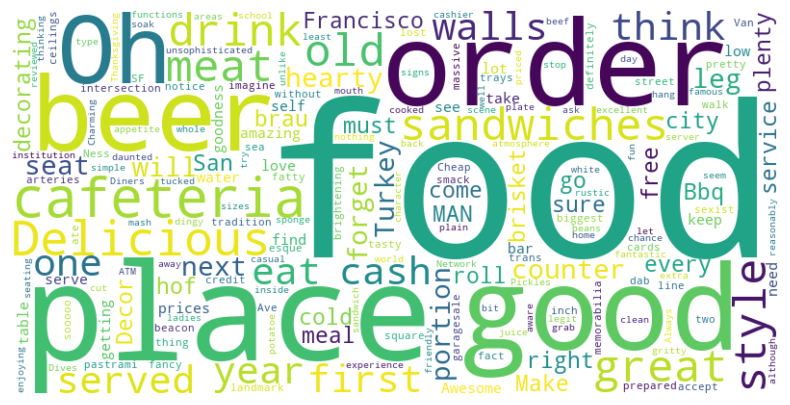

In [ ]:
from wordcloud import WordCloud, STOPWORDS
import matplotlib.pyplot as plt
import pandas as pd
from faker import Faker
import random
from wordcloud import STOPWORDS
from wordcloud import ImageColorGenerator
from PIL import Image
import numpy as np

import pickle

# Load the Counter from the file
with open('pos_counter.pkl', 'rb') as file:
    loaded_counter = pickle.load(file)

# print(loaded_counter)

# Khởi tạo mô-đun Faker để tạo dữ liệu giả định
# fake = Faker()

# Tạo DataFrame mẫu
# data = {
#     'reviewText': [fake.paragraph() for _ in range(100)],
#     'rating': [random.randint(0, 5) for _ in range(100)],
# }



df_sample = pd.DataFrame(loaded_counter, columns = ['Text', 'count'])
# print(df_sample)



# Đường dẫn tuyệt đối của file CSV trên máy tính của bạn
csv_file_path = 'df_ca.csv'

# Đọc dữ liệu từ file CSV
df = pd.read_csv(csv_file_path)
data = pd.DataFrame(df)
filter_data = data[(data['gPlusPlaceId'] == '118445064751572130992') & (data['rating'] >= 4.0)]
# # Tạo một văn bản từ tất cả các reviewText
text = ' '.join(filter_data['reviewText'])

wordcloud = WordCloud(width=800, height=400, background_color='white', colormap='viridis', collocations=False).generate(text)

# # Hiển thị WordCloud bằng matplotlib
plt.figure(figsize=(10, 5))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.show()


[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\NUNNUN\AppData\Roaming\nltk_data...
[nltk_data]   Unzipping tokenizers\punkt.zip.
[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\NUNNUN\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


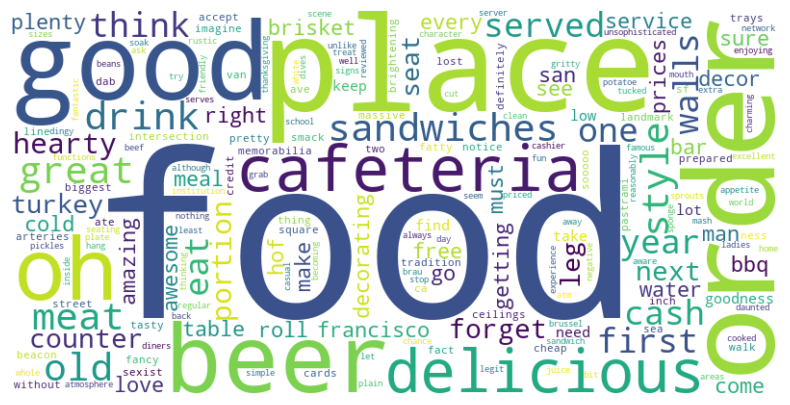

In [ ]:
import pandas as pd
from wordcloud import WordCloud
import matplotlib.pyplot as plt
from nltk import word_tokenize
from nltk.corpus import stopwords
from nltk.probability import FreqDist

# Đường dẫn tuyệt đối của file CSV trên máy tính của bạn
csv_file_path = 'df_ca.csv'

# Đọc dữ liệu từ file CSV
df = pd.read_csv(csv_file_path)
data = pd.DataFrame(df)
filter_data = data[(data['gPlusPlaceId'] == '118445064751572130992') & (data['rating'] >= 4.0)]

# Tạo một văn bản từ tất cả các reviewText
text = ' '.join(filter_data['reviewText'])

import nltk
nltk.download('punkt')
nltk.download('stopwords')

# Tách cụm từ từ văn bản và loại bỏ stop words
stop_words = set(stopwords.words('english'))  # Có thể cần điều chỉnh ngôn ngữ
tokens = word_tokenize(text)
filtered_tokens = [word.lower() for word in tokens if word.isalpha() and word.lower() not in stop_words]

# Tạo WordCloud từ cụm từ
wordcloud = WordCloud(width=800, height=400, background_color='white', colormap='viridis', collocations=False).generate(' '.join(filtered_tokens))

# Hiển thị WordCloud bằng matplotlib
plt.figure(figsize=(10, 5))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.show()


[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\NUNNUN\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\NUNNUN\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     C:\Users\NUNNUN\AppData\Roaming\nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!


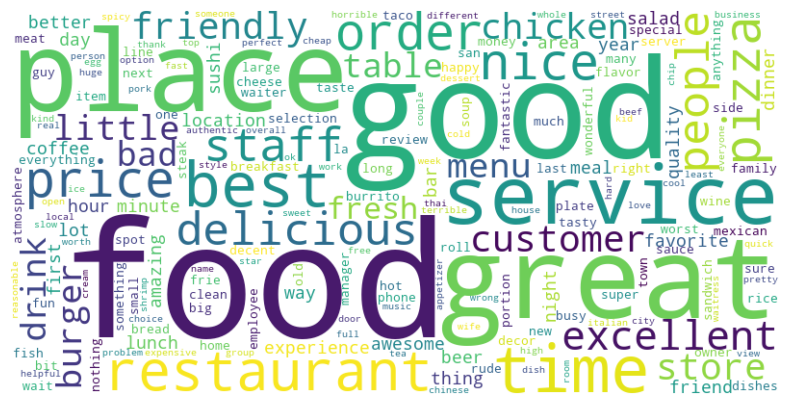

In [ ]:
import pandas as pd
from wordcloud import WordCloud
import matplotlib.pyplot as plt
import nltk
from nltk import word_tokenize, pos_tag
from nltk.corpus import stopwords

# Download NLTK resources
nltk.download('punkt')
nltk.download('stopwords')
nltk.download('averaged_perceptron_tagger')

# Đường dẫn tuyệt đối của file CSV trên máy tính của bạn
csv_file_path = 'df_ca.csv'

# Đọc dữ liệu từ file CSV
df = pd.read_csv(csv_file_path)
data = pd.DataFrame(df)
filter_data = data[(data['gPlusPlaceId'] == '118445064751572130992') & (data['rating'] >= 4.0)]

# Tạo một văn bản từ tất cả các reviewText
text = ' '.join(data['reviewText'])

# Tách cụm từ và nhãn phần loại từ (part-of-speech tags)
tokens = word_tokenize(text)
pos_tags = pos_tag(tokens)

# Lọc danh từ (Nouns) và tính từ (Adjectives)
filtered_tokens = [word.lower() for word, pos in pos_tags if pos.startswith('N') or pos.startswith('J')]

# Loại bỏ stop words
stop_words = set(stopwords.words('english'))
filtered_tokens = [word for word in filtered_tokens if word.isalpha() and word not in stop_words]

# Tạo WordCloud từ cụm từ
wordcloud = WordCloud(width=800, height=400, background_color='white', colormap='viridis', collocations=False).generate(' '.join(filtered_tokens))

# Hiển thị WordCloud bằng matplotlib
plt.figure(figsize=(10, 5))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.show()


In [ ]:
import nltk
nltk.download('punkt')

nltk.download('stopwords')

nltk.download('averaged_perceptron_tagger')

[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\NUNNUN\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\NUNNUN\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     C:\Users\NUNNUN\AppData\Roaming\nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!


True

[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\NUNNUN\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\NUNNUN\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


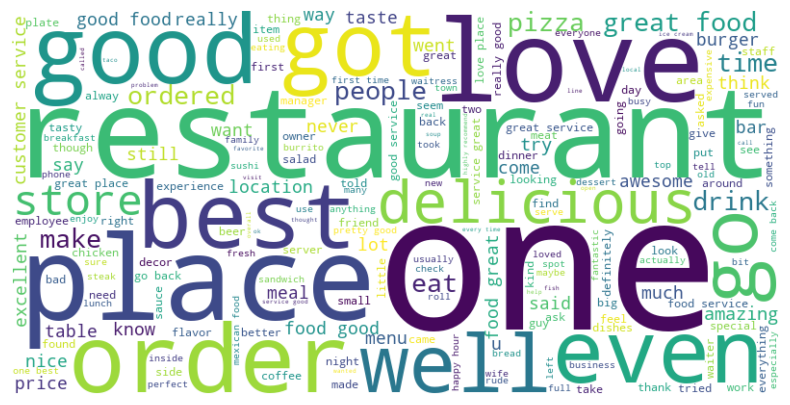

In [ ]:
import pandas as pd
from wordcloud import WordCloud
import matplotlib.pyplot as plt
import nltk
from nltk import sent_tokenize, word_tokenize
from nltk.corpus import stopwords

# Download NLTK resources
nltk.download('punkt')
nltk.download('stopwords')

# Đường dẫn tuyệt đối của file CSV trên máy tính của bạn
csv_file_path = 'df_ca.csv'

# Đọc dữ liệu từ file CSV
df = pd.read_csv(csv_file_path)
data = pd.DataFrame(df)
filter_data = data[(data['gPlusPlaceId'] == '118445064751572130992') & (data['rating'] >= 4.0)]

# Tạo một văn bản từ tất cả các reviewText
text = ' '.join(data['reviewText'])

# Tách thành các từ và loại bỏ stop words
stop_words = set(stopwords.words('english'))
words = [word.lower() for word in word_tokenize(text) if word.isalpha() and word.lower() not in stop_words]

# Ghép từ
finder = nltk.collocations.BigramCollocationFinder.from_words(words)
bigram_measures = nltk.collocations.BigramAssocMeasures()
collocations = finder.nbest(bigram_measures.pmi, 20)  # Số lượng từ ghép bạn muốn giữ lại

# Tạo WordCloud từ các từ và từ ghép
wordcloud = WordCloud(width=800, height=400, background_color='white', colormap='viridis').generate(' '.join(words + [' '.join(collocation) for collocation in collocations]))

# Hiển thị WordCloud bằng matplotlib
plt.figure(figsize=(10, 5))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.show()


In [ ]:
import plotly.graph_objects as go

# Dữ liệu phản hồi
positive_feedback = 48
negative_feedback = 37
neutral_feedback = 15

# Tạo biểu đồ tròn
fig = go.Figure(data=[go.Pie(labels=['Positive', 'Negative', 'Neutral'],
                             values=[positive_feedback, negative_feedback, neutral_feedback],
                             hole=0.4,
                             marker=dict(colors=['#2ca155', '#e63946', '#a8a8a8'],
                                         line=dict(color='white', width=2)),
                             textinfo='label+percent'
                             )])

# Tùy chỉnh layout (nếu cần)
fig.update_layout(title='Distribution of User Feedback',
                  annotations=[dict(text='Total Feedback', x=0.5, y=0.5, font_size=20, showarrow=False)])

# Hiển thị biểu đồ
fig.show()


[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\NUNNUN\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\NUNNUN\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


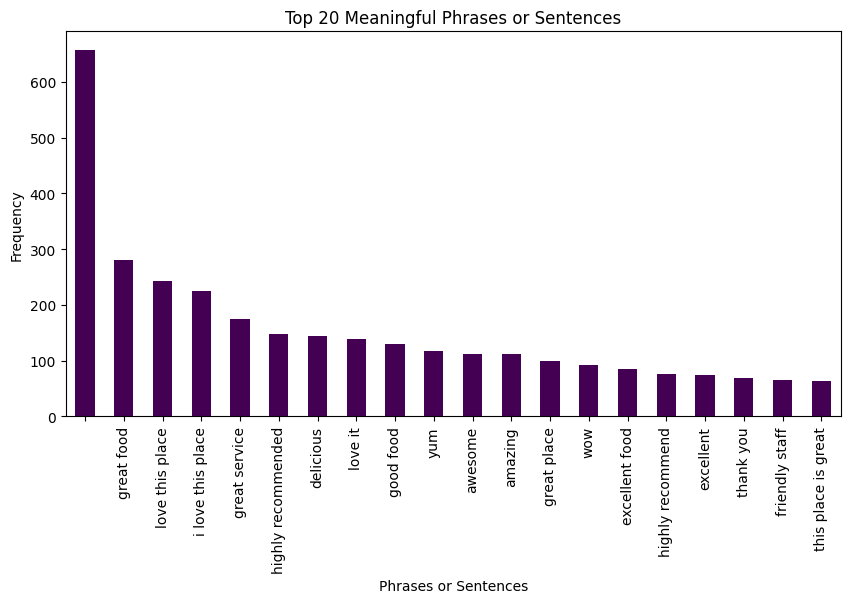

In [ ]:
import pandas as pd
from wordcloud import WordCloud
import matplotlib.pyplot as plt
import nltk
from nltk import sent_tokenize, word_tokenize
from nltk.corpus import stopwords
from collections import Counter
import pymongo

# Download NLTK resources
nltk.download('punkt')
nltk.download('stopwords')

# Connect to local MongoDB server
client = MongoClient("mongodb://127.0.0.1:27017/")
mydb = client["ie212_o11_group7"]
collection_reviews = mydb.reviews

df = collection_reviews()
data = pd.DataFrame(df)

# Tạo một văn bản từ tất cả các reviewText
text = ' '.join(filter_data['reviewText'])

# Tách thành các câu
sentences = sent_tokenize(text)

# Xử lý và lọc các cụm từ hoặc câu có ý nghĩa
meaningful_phrases = []
for sentence in sentences:
    words = [word.lower() for word in word_tokenize(sentence) if word.isalpha()]
    meaningful_phrases.append(' '.join(words))

# Đếm tần suất xuất hiện của từng cụm từ hoặc câu
phrase_freq = Counter(meaningful_phrases)

# Chuyển đổi kết quả thành DataFrame để vẽ biểu đồ cột
df_phrase_freq = pd.DataFrame.from_dict(phrase_freq, orient='index', columns=['count'])
df_phrase_freq = df_phrase_freq.sort_values(by='count', ascending=False)

# Vẽ biểu đồ cột
plt.figure(figsize=(10, 5))
df_phrase_freq['count'].head(20).plot(kind='bar', colormap='viridis')
plt.title('Top 20 Meaningful Phrases or Sentences')
plt.xlabel('Phrases or Sentences')
plt.ylabel('Frequency')
plt.show()


In [12]:
import csv
import pandas as pd
from pymongo import MongoClient
from sklearn.feature_extraction.text import CountVectorizer
from collections import Counter
import re
from gensim.utils import simple_preprocess

# Connect to MongoDB
client = MongoClient("mongodb://127.0.0.1:27017/")
mydb = client["ie212_o11_group7"]
collection_reviews = mydb["reviews"]

# Tạo danh sách các câu và sentiments
sentences = []
sentiments = []

# Lấy dữ liệu từ MongoDB
cursor = collection_reviews.find({'sentiment': 'positive'})
for document in cursor:
    # Thêm các câu vào danh sách
    sentences.extend(document['sentences'])
    # Thêm sentiment tương ứng
    sentiments.extend(['positive'] * len(document['sentences']))

# Tiền xử lý văn bản
cleaned_sentences = [' '.join(simple_preprocess(sentence, min_len=2, max_len=15)) for sentence in sentences]

# Sử dụng CountVectorizer để đếm số lần xuất hiện của từng từ
vectorizer = CountVectorizer()
X = vectorizer.fit_transform(cleaned_sentences)

# Đếm số lần xuất hiện của từng từ và vẽ biểu đồ
words_count = Counter(vectorizer.get_feature_names_out())

# Chọn số lượng từ xuất hiện nhiều nhất để vẽ biểu đồ
top_words_count = words_count.most_common(10)

# In ra các từ và số lần xuất hiện của chúng
print(top_words_count)


[('a_', 1), ('a_beer', 1), ('a_bite', 1), ('a_break', 1), ('a_bảo', 1), ('a_bảo_vệ', 1), ('a_chung', 1), ('a_chảnh', 1), ('a_city', 1), ('a_clean', 1)]


In [14]:
df = pd.DataFrame(list(cursor))

# Hiển thị DataFrame
print(df)

Empty DataFrame
Columns: []
Index: []


In [15]:
print(sentences)

['Quán cf mình tới vài lần vì yên_tĩnh và không quá đông mặc_dù là cuối tuần .', 'Không_gian khá rộng , không quá đặc_biệt đặc_sắc nhưng lại hợp gu mình . nước uống giá không thấp , vị khá ổn .', 'Nhân_viên cũng nhanh_nhẹn nhiệt_tình dễ_thương .', 'Mn tới thì gửi xe toà nhà bên ngoài , có hỗ_trợ phí gửi xe .', 'Quán cà hê thích_hợp cho những người hướng_nội ..', 'Quán siêu rộng , có không_gian máy_lạnh , ngoài_trời ..', 'Nhân_viên thân_thiện dễ_thương .', 'Nước bình_thường .', 'Nói_chung khá thích_hợp để làm_việc , hoặc cho những bạn hướng_nội .', 'Quán có nhiều không_gian khá đẹp để chụp hình sống ảo .', 'Đồ uống cũng tạm được không xuất_sắc lắm .', 'Không_gian cực chill , rất thoáng , trần cao , nhân_viên rất thân_thiện', 'Quán có không_gian rộng_rãi và rất thoáng vì có cả không_gian in-door và out-door .', 'Quán khá đầu_tư vào trang_trí nên nếu bạn nào có nhu_cầu đến để chụp ảnh thì khá phù_hợp , tuy_nhiên do có không_gian ngoài_trời nên các bạn cân_nhắc đi chụp buổi sáng sẽ đẹp hơn

[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\NUNNUN\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\NUNNUN\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


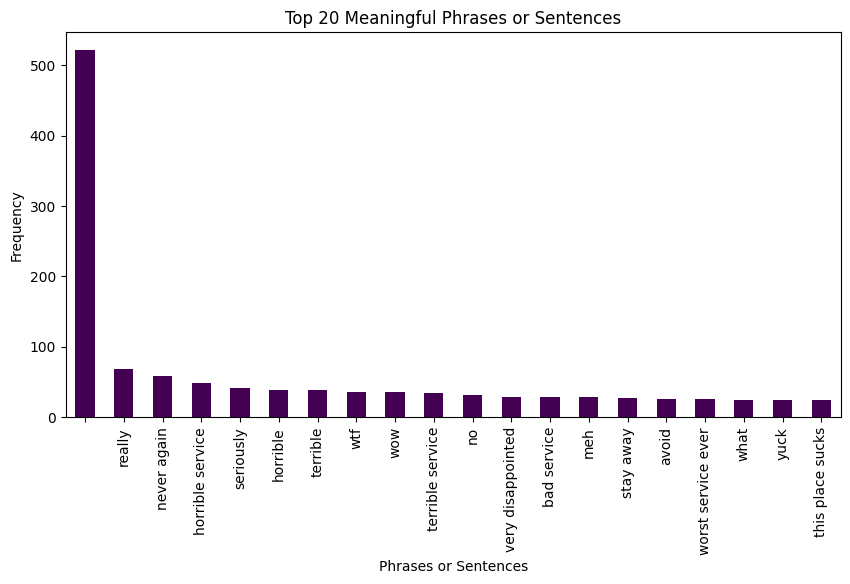

In [ ]:
import pandas as pd
from wordcloud import WordCloud
import matplotlib.pyplot as plt
import nltk
from nltk import sent_tokenize, word_tokenize
from nltk.corpus import stopwords
from collections import Counter

# Download NLTK resources
nltk.download('punkt')
nltk.download('stopwords')

# Đường dẫn tuyệt đối của file CSV trên máy tính của bạn
csv_file_path = 'df_ca.csv'

# Đọc dữ liệu từ file CSV
df = pd.read_csv(csv_file_path)
data = pd.DataFrame(df)
filter_data = data[(data['rating'] < 4.0)]

# Tạo một văn bản từ tất cả các reviewText
text = ' '.join(filter_data['reviewText'])

# Tách thành các câu
sentences = sent_tokenize(text)

# Xử lý và lọc các cụm từ hoặc câu có ý nghĩa
meaningful_phrases = []
for sentence in sentences:
    words = [word.lower() for word in word_tokenize(sentence) if word.isalpha()]
    meaningful_phrases.append(' '.join(words))

# Đếm tần suất xuất hiện của từng cụm từ hoặc câu
phrase_freq = Counter(meaningful_phrases)

# Chuyển đổi kết quả thành DataFrame để vẽ biểu đồ cột
df_phrase_freq = pd.DataFrame.from_dict(phrase_freq, orient='index', columns=['count'])
df_phrase_freq = df_phrase_freq.sort_values(by='count', ascending=False)

# Vẽ biểu đồ cột
plt.figure(figsize=(10, 5))
df_phrase_freq['count'].head(20).plot(kind='bar', colormap='viridis')
plt.title('Top 20 Meaningful Phrases or Sentences')
plt.xlabel('Phrases or Sentences')
plt.ylabel('Frequency')
plt.show()


[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\NUNNUN\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\NUNNUN\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


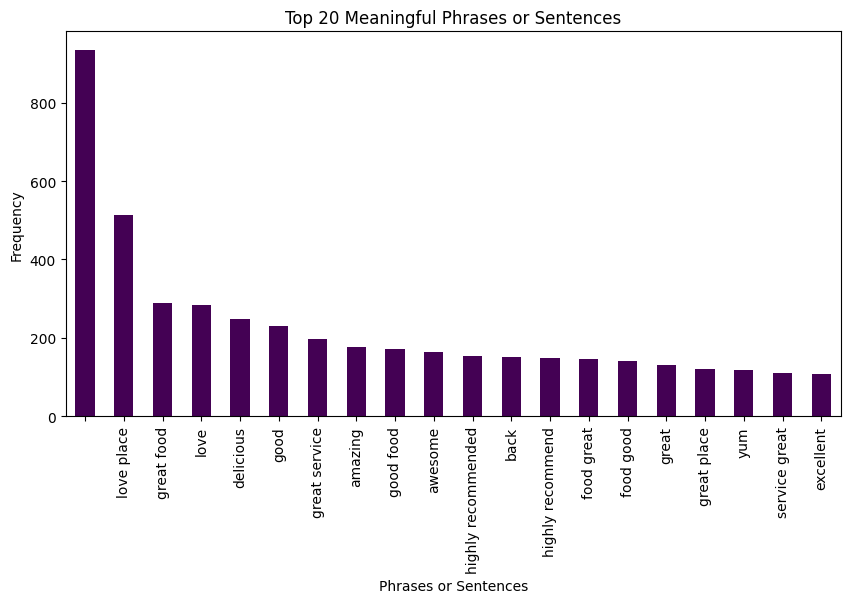

In [ ]:
import pandas as pd
from wordcloud import WordCloud
import matplotlib.pyplot as plt
import nltk
from nltk import sent_tokenize, word_tokenize
from nltk.corpus import stopwords
from collections import Counter

# Download NLTK resources
nltk.download('punkt')
nltk.download('stopwords')

# Đường dẫn tuyệt đối của file CSV trên máy tính của bạn
csv_file_path = 'df_ca.csv'

# Đọc dữ liệu từ file CSV
df = pd.read_csv(csv_file_path)
data = pd.DataFrame(df)
filter_data = data[(data['rating'] >= 4.0)]

# Tạo một văn bản từ tất cả các reviewText
text = ' '.join(filter_data['reviewText'])

# Tách thành các câu
sentences = sent_tokenize(text)

# Xử lý và lọc các cụm từ hoặc câu có ý nghĩa
meaningful_phrases = []
stop_words = set(stopwords.words('english'))
for sentence in sentences:
    words = [word.lower() for word in word_tokenize(sentence) if word.isalpha() and word.lower() not in stop_words]
    meaningful_phrases.append(' '.join(words))

# Đếm tần suất xuất hiện của từng cụm từ hoặc câu
phrase_freq = Counter(meaningful_phrases)

# Chuyển đổi kết quả thành DataFrame để vẽ biểu đồ cột
df_phrase_freq = pd.DataFrame.from_dict(phrase_freq, orient='index', columns=['count'])
df_phrase_freq = df_phrase_freq.sort_values(by='count', ascending=False)


In [ ]:
print(df_phrase_freq_sorted.iloc[135720:135762].head(100))


                    count
service good           54
thumbs way             55
great atmosphere       56
amazing food           57
fantastic              58
place amazing          59
good service           66
love food              66
thanks                 67
yummy                  68
definitely back        73
best                   74
place great            76
food amazing           78
thank                  80
food delicious         82
go                     84
loved                  86
food excellent         87
excellent food         90
friendly staff         93
wow                    94
excellent             107
service great         111
yum                   119
great place           121
great                 132
food good             141
food great            147
highly recommend      148
back                  152
highly recommended    153
awesome               165
good food             173
amazing               177
great service         198
good                  231
delicious   

In [ ]:
# Sắp xếp DataFrame theo tần suất giảm dần
df_phrase_freq_sorted = df_phrase_freq.sort_values(by='count', ascending=True)

# Vẽ biểu đồ cột với trục x và y đã được đảo ngược
plt.figure(figsize=(10, 5))
df_phrase_freq_sorted['count'].tail(20).plot(kind='barh', colormap='viridis')  # Sử dụng 'barh' thay vì 'bar'
plt.title('Top 20 Meaningful Phrases or Sentences')
plt.xlabel('Frequency')  # Đổi tên của trục x thành Frequency
plt.ylabel('Phrases or Sentences')  # Đổi tên của trục y thành Phrases or Sentences
plt.show()



C:\Users\NUNNUN\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.9_qbz5n2kfra8p0\LocalCache\local-packages\Python39\site-packages\IPython\core\pylabtools.py:152: UserWarning:

Glyph 24456 (\N{CJK UNIFIED IDEOGRAPH-5F88}) missing from current font.

C:\Users\NUNNUN\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.9_qbz5n2kfra8p0\LocalCache\local-packages\Python39\site-packages\IPython\core\pylabtools.py:152: UserWarning:

Glyph 22810 (\N{CJK UNIFIED IDEOGRAPH-591A}) missing from current font.

C:\Users\NUNNUN\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.9_qbz5n2kfra8p0\LocalCache\local-packages\Python39\site-packages\IPython\core\pylabtools.py:152: UserWarning:

Glyph 33258 (\N{CJK UNIFIED IDEOGRAPH-81EA}) missing from current font.

C:\Users\NUNNUN\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.9_qbz5n2kfra8p0\LocalCache\local-packages\Python39\site-packages\IPython\core\pylabtools.py:152: UserWarning:

Glyph 24049 (\N{CJK UNIFIED IDEOGRAPH-5DF1}) 

KeyboardInterrupt: 

In [ ]:
import pickle

with open('counter.pkl', 'rb') as file:
    data = pickle.load(file)

In [ ]:
import pickle

# Load data from the pickle file
with open('counter.pkl', 'rb') as file:
    data = pickle.load(file)

# Replace 'your_key_here' with the actual key you want to access
your_key = '104231480695579463827'

# Access the data for the specified key
if your_key in data:
    print(data[your_key]['positive'])
else:
    print(f"Key '{your_key}' not found in the dictionary.")


{'dodge': 14, 'lavaca': 13, 'service': 13, 'port': 12, 'truck': 6, 'department': 6, 'car': 6, 'customer': 4, 'beware': 4, 'work': 3, 'durango': 3, 'kristen': 3, 'mueller': 3, 'carlos': 3, 'rudy': 3, 'oil': 3, 'years': 3, 'reason': 3, 'approval': 3, 'sales': 3}


In [ ]:
positive_data = data[your_key]['positive']
vv = pd.DataFrame([positive_data]).transpose()
vv = vv.rename(columns={0: 'count'})
vv


,count
dodge,14
lavaca,13
service,13
port,12
truck,6
department,6
car,6
customer,4
beware,4
work,3


In [4]:
import plotly.graph_objects as go

def draw_donut_chart(neg_count, pos_count, neu_count, avg_star):
    # Calculate percentages
    total = neg_count + pos_count + neu_count
    neg_percentage = (neg_count / total) * 100
    pos_percentage = (pos_count / total) * 100
    neu_percentage = (neu_count / total) * 100

    fig = go.Figure(data=[go.Pie(labels=['Positive', 'Negative', 'Neutral'],
                                values=[pos_percentage, neg_percentage, neu_percentage],
                                hole=0.4,
                                marker=dict(colors=['#2ca155', '#e63946', '#a8a8a8'],
                                            line=dict(color='white', width=2)),
                                textinfo='label+percent'
                                )])

    # Tùy chỉnh layout (nếu cần)
    fig.update_layout(title='Distribution of User Feedback',
                    annotations=[dict(text=f'{avg_star:.2f} \u2605', x=0.5, y=0.5, font_size=24, showarrow=False, font_color="#f86134")])

    # Show the plot
    fig.show()

# Example usage
draw_donut_chart(neg_count=30, pos_count=50, neu_count=20, avg_star=4.2)

In [ ]:
# Sort the DataFrame by the 'count' column in descending order
pos_data = vv.sort_values(by='count', ascending=True)

# Calculate percentage
total_count = pos_data['count'].sum()
pos_data['percentage'] = pos_data['count'] / total_count * 100

# Keep only the top 10 items
top_10 = pos_data.tail(10)

# Sum the remaining items and create an 'Other' category
other_category = pd.DataFrame({'count': [total_count - top_10['count'].sum()], 
                                'percentage': [(total_count - top_10['count'].sum()) / total_count * 100]}, 
                                index=['Other'])

# Concatenate the top 10 items and the 'Other' category
pos_data_combined = pd.concat([top_10, other_category])

# Convert 'percentage' to string for color parameter
pos_data_combined['percentage_str'] = pos_data_combined['percentage'].apply(lambda x: f"{x:.2f}%").astype(str)

# Plot the horizontal bar chart using Plotly with color and text parameters
fig = px.bar(pos_data_combined, y=pos_data_combined.index, x='count', color_discrete_sequence=['#a0da3a'],
                labels={'index': 'Words', 'count': 'Count', 'percentage_str': 'Percentage'},
                title='Top 10 những điều được đánh giá tích cực', orientation='h', text='percentage_str')

# Update the color bar label
fig.update_coloraxes(colorbar_title='Percentage %')

# Show the plot
fig.show()

In [ ]:
# Sort the DataFrame by the 'count' column in descending order
neg_data = vv.sort_values(by='count', ascending=True)

# Calculate percentage
total_count = neg_data['count'].sum()
neg_data['percentage'] = neg_data['count'] / total_count * 100

# Keep only the top 10 items
top_10 = neg_data.tail(10)

# Sum the remaining items and create an 'Other' category
other_category = pd.DataFrame({'count': [total_count - top_10['count'].sum()], 
                                'percentage': [(total_count - top_10['count'].sum()) / total_count * 100]}, 
                                index=['Other'])

# Concatenate the top 10 items and the 'Other' category
neg_data_combined = pd.concat([top_10, other_category])

# Convert 'percentage' to string for color parameter
neg_data_combined['percentage_str'] = neg_data_combined['percentage'].apply(lambda x: f"{x:.2f}%").astype(str)

# Plot the horizontal bar chart using Plotly with color and text parameters
fig = px.bar(neg_data_combined, y=neg_data_combined.index, x='count', color_discrete_sequence=['#f86134'],
                labels={'index': 'Words', 'count': 'Count', 'percentage_str': 'Percentage'},
                title='Top 10 những điều được đánh giá tiêu cực', orientation='h', text='percentage_str')

# Update the color bar label
fig.update_coloraxes(colorbar_title='Percentage %')

# Show the plot
fig.show()

In [13]:
from pymongo import MongoClient
from gensim.utils import simple_preprocess

# Connect to MongoDB
client = MongoClient("mongodb://127.0.0.1:27017/")
mydb = client["ie212_o11_group7"]
collection = mydb["reviews"]

cursor = collection.find({'sentiment': 'positive'})

sentences = []
sentiments = []
for document in cursor:
    # Thêm các câu vào danh sách
    sentences.extend(document['sentences'])
    # Thêm sentiment tương ứng
    sentiments.extend(['positive'] * len(document['sentences']))

# Tiền xử lý văn bản
# cleaned_sentences = [' '.join(simple_preprocess(sentence, min_len=2, max_len=15)) for sentence in sentences]

# In ra câu thứ 21 trong danh sách các câu có sentiment là "positive"
print(len(sentences))
print(sentences[:20])


617866
['Quán cf mình tới vài lần vì yên_tĩnh và không quá đông mặc_dù là cuối tuần .', 'Không_gian khá rộng , không quá đặc_biệt đặc_sắc nhưng lại hợp gu mình . nước uống giá không thấp , vị khá ổn .', 'Nhân_viên cũng nhanh_nhẹn nhiệt_tình dễ_thương .', 'Mn tới thì gửi xe toà nhà bên ngoài , có hỗ_trợ phí gửi xe .', 'Quán cà hê thích_hợp cho những người hướng_nội ..', 'Quán siêu rộng , có không_gian máy_lạnh , ngoài_trời ..', 'Nhân_viên thân_thiện dễ_thương .', 'Nước bình_thường .', 'Nói_chung khá thích_hợp để làm_việc , hoặc cho những bạn hướng_nội .', 'Quán có nhiều không_gian khá đẹp để chụp hình sống ảo .', 'Đồ uống cũng tạm được không xuất_sắc lắm .', 'Không_gian cực chill , rất thoáng , trần cao , nhân_viên rất thân_thiện', 'Quán có không_gian rộng_rãi và rất thoáng vì có cả không_gian in-door và out-door .', 'Quán khá đầu_tư vào trang_trí nên nếu bạn nào có nhu_cầu đến để chụp ảnh thì khá phù_hợp , tuy_nhiên do có không_gian ngoài_trời nên các bạn cân_nhắc đi chụp buổi sáng sẽ 

In [17]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt

# Kết hợp các câu thành một chuỗi duy nhất
text = ' '.join(sentences)

# Tiền xử lý dữ liệu (nếu cần)

# Tạo word cloud
wordcloud = WordCloud(width=800, height=400, background_color='white').generate(text)

# Hiển thị word cloud
plt.figure(figsize=(10, 5))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.show()